Author:
Muneeb Ur Rehman 21i0392,
Firzeen Qaiser 21i0782

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## DATASET
We Used open source dataset named drishti rim one that contains the images for both healty and gloucomic eye

dataset link
https://drive.google.com/drive/u/0/folders/12aqtQbLMIDTBSX9e02v3qZxh6DUhCyWZ

In [ ]:
import os
directory_healthy = "/content/drive/My Drive/dip_project/NORMAL"
directory_glaucoma = "/content/drive/My Drive/dip_project/GLAUCOMA"
directory_glaucoma_test = "/content/drive/My Drive/dip_project/GLAUCOMA_TEST"
directory_healthy_test = "/content/drive/My Drive/dip_project/NORMAL_TEST"



## Importing Libraries

In [ ]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
import scipy
import scipy.stats
import random
import math
import keras
from keras.models import Sequential
from keras.layers import Dense,Dropout,Activation
from keras.optimizers import SGD
from keras.utils import plot_model
from tabulate import tabulate
from scipy import ndimage
import cv2
from matplotlib.image import imread
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
matplotlib.rcParams['figure.figsize']=(20.0,10.0)

## Implementation of our CNN with the help of sequential modal

In [ ]:
def CNN(inputDim,outputDim):
    # Initializing a sequential modal
    cnn=Sequential()
    # Add the first fully connected layer with 1024 units, using 'tanh' activation function
    cnn.add(Dense(1024,input_dim=inputDim,kernel_initializer='uniform',activation='tanh'))
    # Add the second fully connected layer with 1024 units, using 'tanh' activation function
    cnn.add(Dense(1024,input_dim=1024,kernel_initializer='uniform',activation='tanh'))

    # Add the output layer with 'outputDim' units and 'sigmoid' activation function
    cnn.add(Dense(outputDim,input_dim=1024,kernel_initializer='uniform'))

    #Activation layer for binary classification
    cnn.add(Activation('sigmoid'))
    cnn.summary()
    return cnn

## Training the modal

In [ ]:
def TrainNetwork(compiledNetwork,trainX,trainY,epochs):
    for iEpoch in range(epochs):
        compiledNetwork.train_on_batch(trainX,trainY) #Compiling oour modal on small batches
        if iEpoch%100 ==0:
          print(iEpoch)
    return compiledNetwork

In [ ]:



originalGlaucomaTrain=[None]*41   #contains the images of glaucomic eye
trainX=np.zeros((82,256 * 256))
for i, filename in enumerate(os.listdir(directory_glaucoma)):
   if filename.endswith(".png"):
    file_path = os.path.join(directory_glaucoma, filename)
    face=imread(file_path)
    face = cv2.cvtColor(face, cv2.COLOR_RGB2GRAY)
    print(file_path)
    originalGlaucomaTrain[i]=face;
    face=face.flatten()  #flattening the images
    trainX[i,:]=face/256.0 #normalizing

originalHealthyTrain=[None]*41  #contain the images of healthy eye
for i, filename in enumerate(os.listdir(directory_healthy)):
   if filename.endswith(".png"):
    file_path = os.path.join(directory_healthy, filename)
    face=imread(file_path)
    face = cv2.cvtColor(face, cv2.COLOR_RGB2GRAY)
    print(file_path)
    originalHealthyTrain[i]=face;
    face=face.flatten() #flattening the images
    trainX[i+42,:]=face/256.0 #normalizing

# Initialize trainY dynamically based on the number of samples in trainX
trainY = np.zeros((trainX.shape[0], 1))

# Update labels for glaucoma images to 1(first 41 samples)
trainY[:41] = 1

# Update labels for healthy images to 0(remaining samples)
trainY[41:] = 0

net=CNN(trainX.shape[1],1)

net.compile(loss='binary_crossentropy',optimizer="SGD") #compiling our modal


trainedNet=TrainNetwork(net,trainX,trainY,2000)


/content/drive/My Drive/dip_project/GLAUCOMA/06.png
/content/drive/My Drive/dip_project/GLAUCOMA/07.png
/content/drive/My Drive/dip_project/GLAUCOMA/16.png
/content/drive/My Drive/dip_project/GLAUCOMA/40.png
/content/drive/My Drive/dip_project/GLAUCOMA/13.png
/content/drive/My Drive/dip_project/GLAUCOMA/03.png
/content/drive/My Drive/dip_project/GLAUCOMA/19.png
/content/drive/My Drive/dip_project/GLAUCOMA/31.png
/content/drive/My Drive/dip_project/GLAUCOMA/15.png
/content/drive/My Drive/dip_project/GLAUCOMA/29.png
/content/drive/My Drive/dip_project/GLAUCOMA/01.png
/content/drive/My Drive/dip_project/GLAUCOMA/35.png
/content/drive/My Drive/dip_project/GLAUCOMA/02.png
/content/drive/My Drive/dip_project/GLAUCOMA/24.png
/content/drive/My Drive/dip_project/GLAUCOMA/20.png
/content/drive/My Drive/dip_project/GLAUCOMA/14.png
/content/drive/My Drive/dip_project/GLAUCOMA/22.png
/content/drive/My Drive/dip_project/GLAUCOMA/34.png
/content/drive/My Drive/dip_project/GLAUCOMA/17.png
/content/dri

## Printing the trained dataset images

<ipython-input-7-2f02dd679cc8>:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  f,axarr=plt.subplots(1,2)


TypeError: Image data of dtype object cannot be converted to float

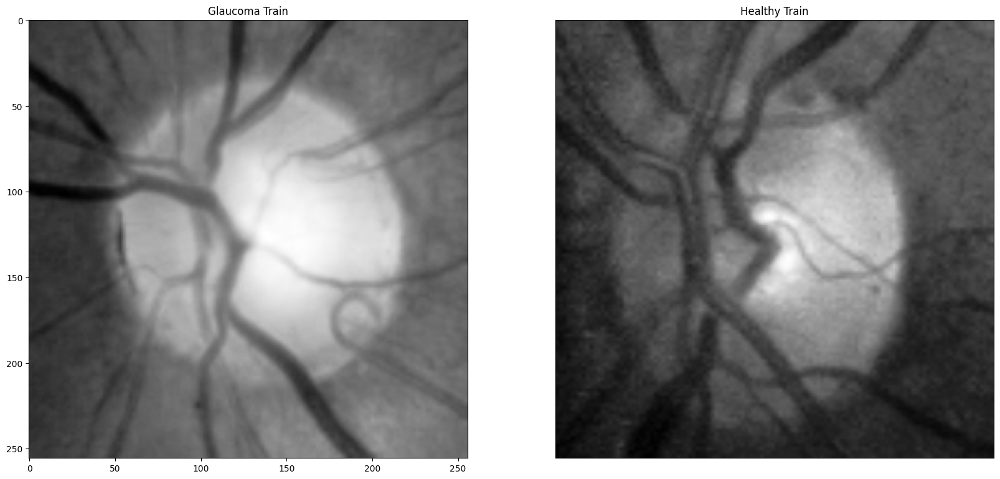

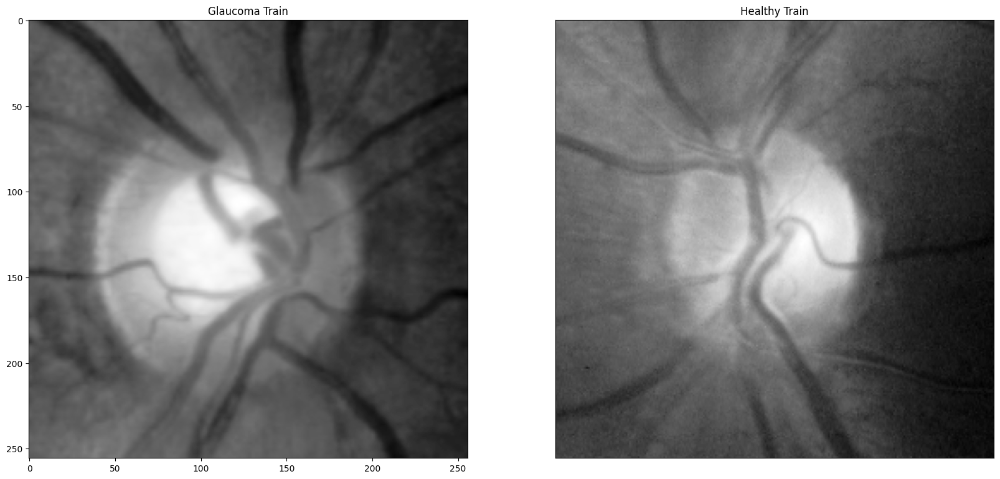

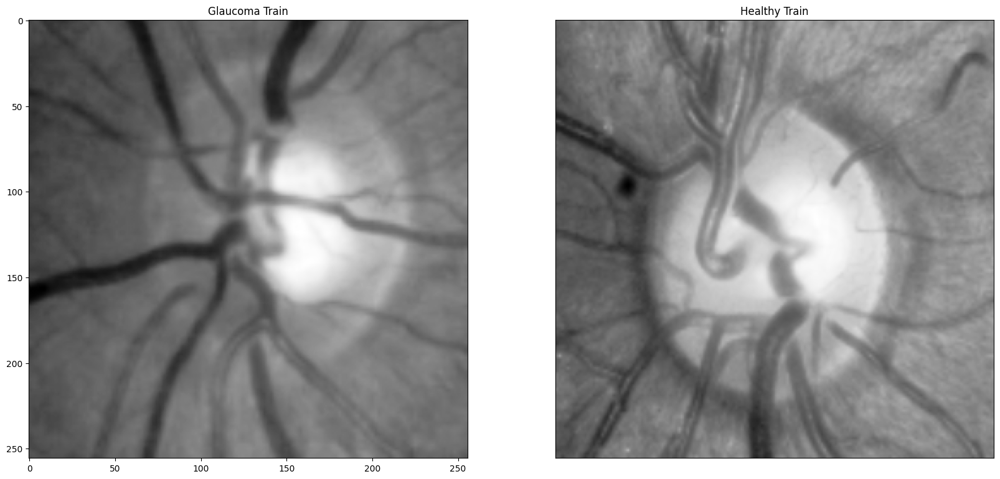

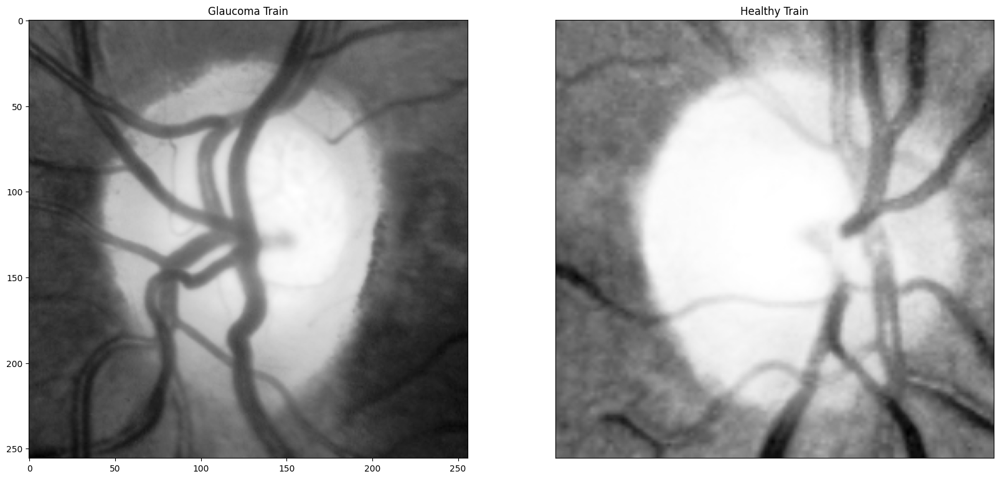

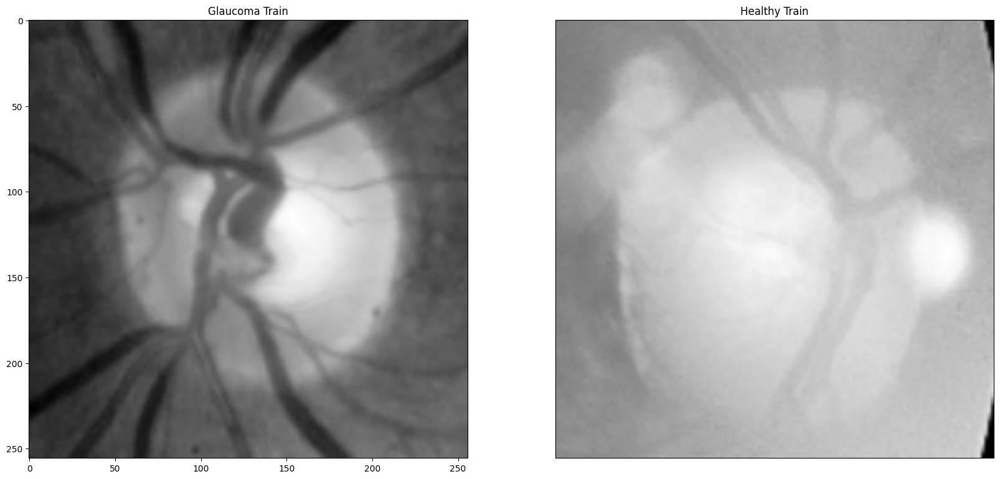

...

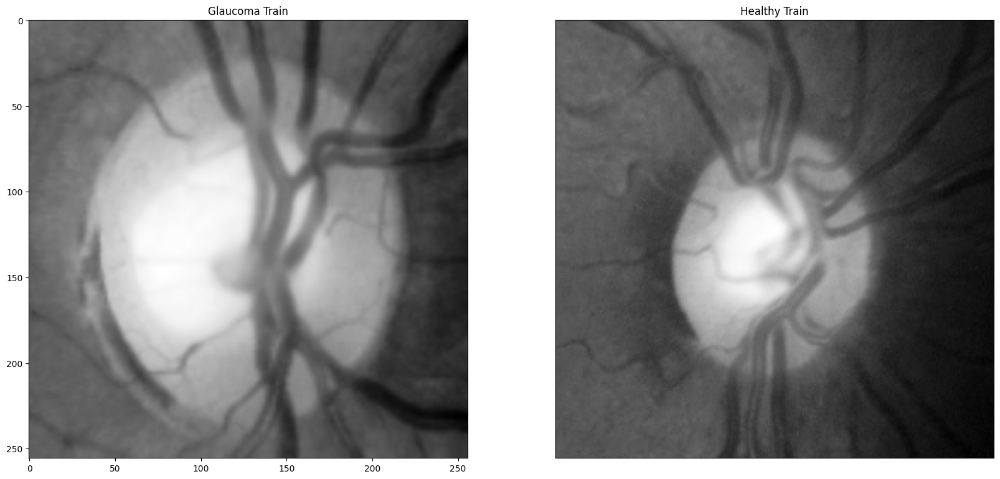

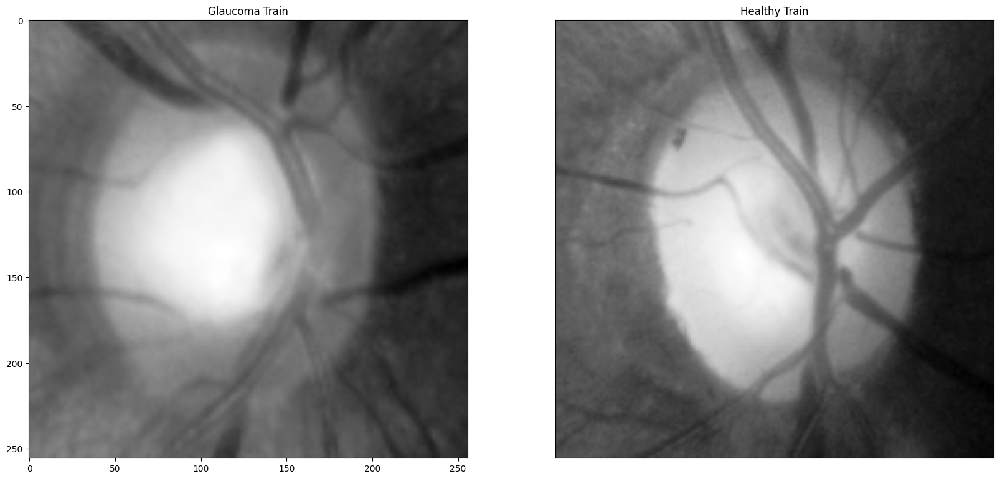

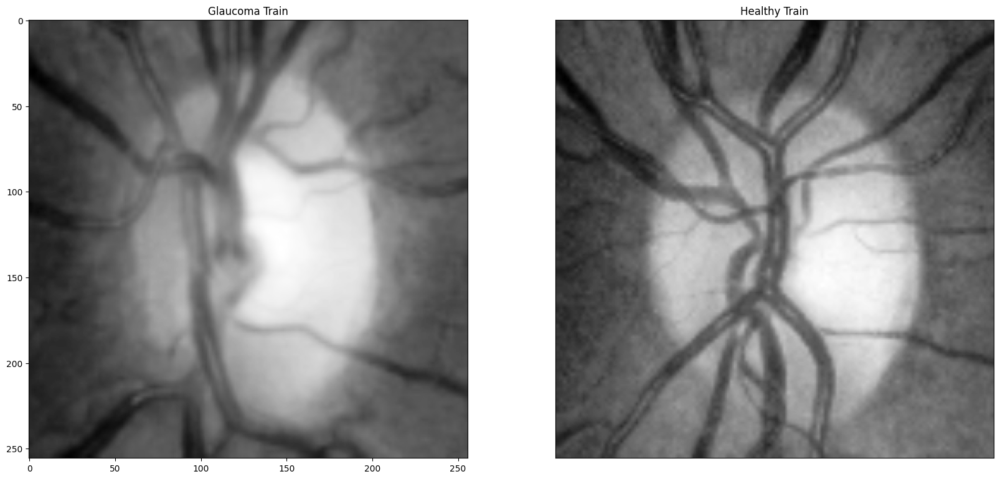

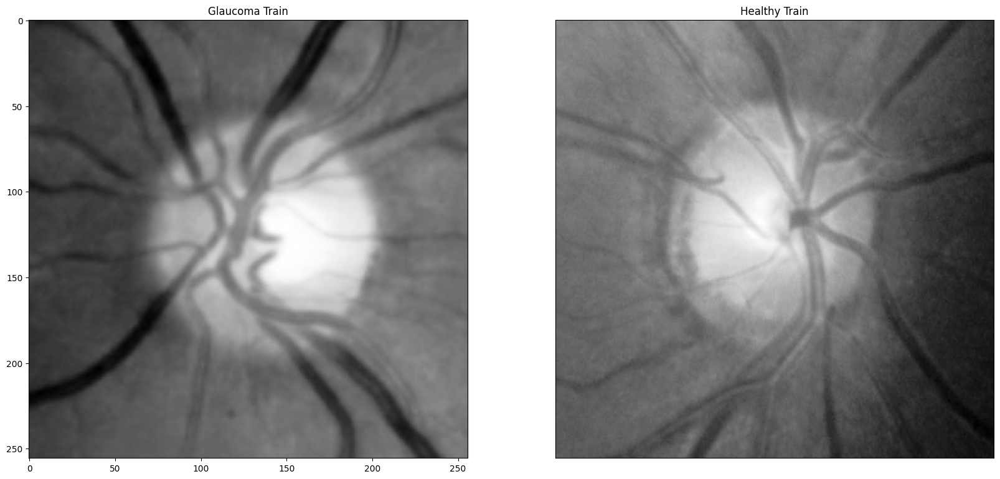

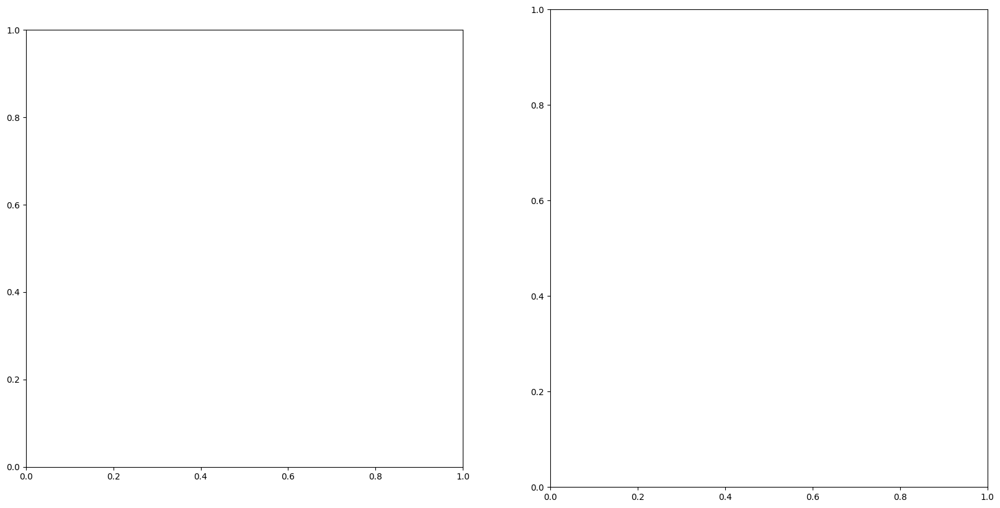

In [ ]:

for iPic in range(41):
    f,axarr=plt.subplots(1,2)
    axarr[0].imshow(originalGlaucomaTrain[iPic],cmap='Greys_r')
    axarr[0].set_title('Glaucoma Train')
    axarr[0].get_xaxis().set_visible(True)
    axarr[0].get_yaxis().set_visible(True)
    axarr[1].imshow(originalHealthyTrain[iPic],cmap='Greys_r')
    axarr[1].set_title('Healthy Train')
    axarr[1].get_xaxis().set_visible(False)
    axarr[1].get_yaxis().set_visible(False)


## Testing the network

In [ ]:

testX=np.zeros((10,256*256))
originalGlaucomaTest=[None]*5 # 5 gloucomic images
originalHealthyTest=[None]*5 # 5 healthy images

In [ ]:

counter = 0
for i, filename in enumerate(os.listdir(directory_glaucoma_test)):
   if counter>=5:
    break
   if filename.endswith(".png"):
    file_path = os.path.join(directory_glaucoma_test, filename)
    face=imread(file_path)
    face = cv2.cvtColor(face, cv2.COLOR_RGB2GRAY)
    print(file_path)
    originalGlaucomaTest[i]=face;  # storing the gloucomic images
    face=face.flatten() #flattening the images
    testX[i,:]=face/256.0
    counter= counter+1

counter = 0
for i, filename in enumerate(os.listdir(directory_healthy_test)):
   if counter>=5:
    break
   if filename.endswith(".png"):
    file_path = os.path.join(directory_healthy_test, filename)
    face=imread(file_path)
    face = cv2.cvtColor(face, cv2.COLOR_RGB2GRAY)
    print(file_path)
    originalHealthyTest[i]=face; #storing the healthy images
    face=face.flatten() #flattening the images
    testX[i+5,:]=face/256.0
    counter = counter+1

/content/drive/My Drive/dip_project/GLAUCOMA_TEST/04.png
/content/drive/My Drive/dip_project/GLAUCOMA_TEST/03.png
/content/drive/My Drive/dip_project/GLAUCOMA_TEST/02.png
/content/drive/My Drive/dip_project/GLAUCOMA_TEST/05.png
/content/drive/My Drive/dip_project/GLAUCOMA_TEST/01.png
/content/drive/My Drive/dip_project/NORMAL_TEST/03.png
/content/drive/My Drive/dip_project/NORMAL_TEST/02.png
/content/drive/My Drive/dip_project/NORMAL_TEST/01.png
/content/drive/My Drive/dip_project/NORMAL_TEST/05.png
/content/drive/My Drive/dip_project/NORMAL_TEST/04.png


In [ ]:
out=trainedNet.predict(testX) #array that store the probabilities of test images
print(out)

1/1 [==============================] - 0s 325ms/step
[[0.51506525]
 [0.51492333]
 [0.5404794 ]
 [0.5075736 ]
 [0.52721494]
 [0.46578193]
 [0.45955378]
 [0.46979192]
 [0.4725526 ]
 [0.47002864]]


## Final Results

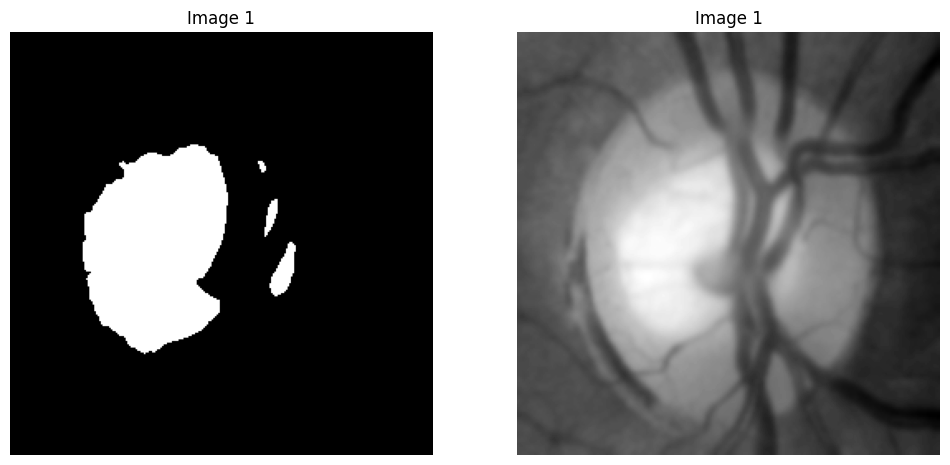

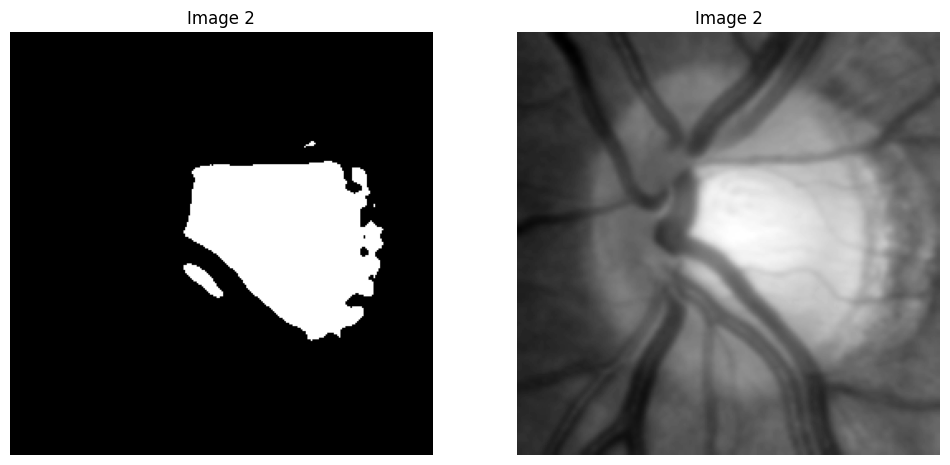

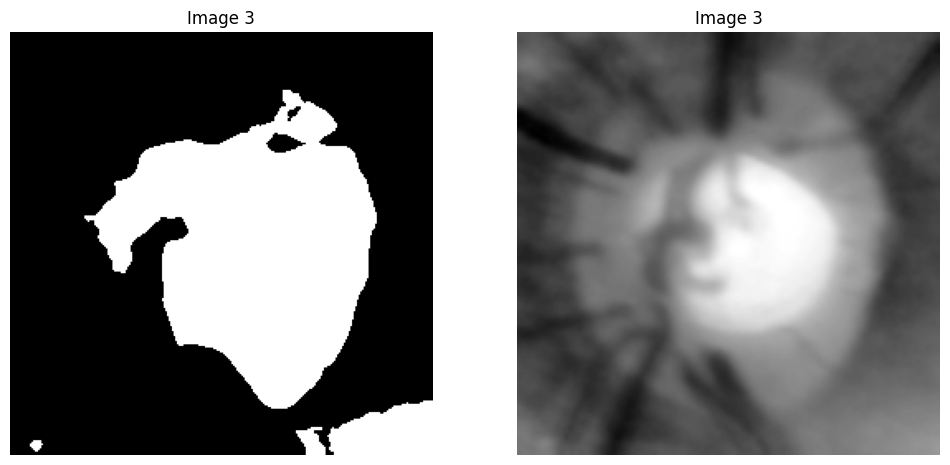

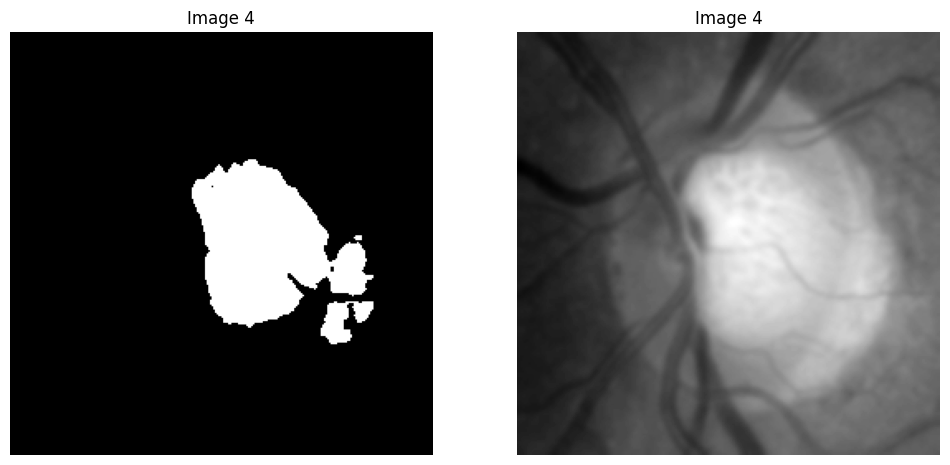

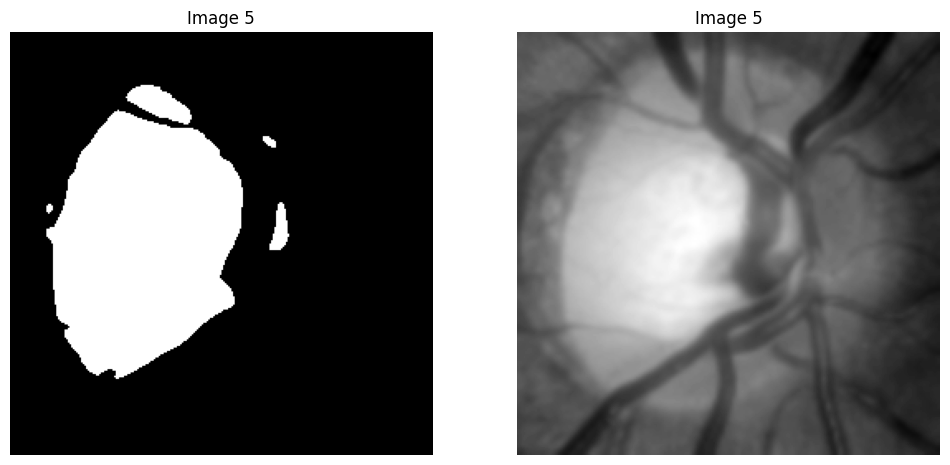

In [ ]:
#Postprocessing for the glaucomic eye images by doing soothing and thresholding
for i, filename in enumerate(os.listdir(directory_glaucoma_test)):
   if filename.endswith(".png"):
    file_path = os.path.join(directory_glaucoma_test, filename)
    img = cv2.imread(file_path)

    # Convert the image to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    smoothed_img = cv2.GaussianBlur(gray_img,(5,5),0)
    ret, thresh_img = cv2.threshold(smoothed_img, 175, 255, cv2.THRESH_BINARY)

    # Display the grayscale image
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(thresh_img, cmap='gray')
    plt.axis('off')
    plt.title(f'Image {i+1}')

    plt.subplot(1, 2, 2)
    plt.imshow(smoothed_img, cmap='gray')
    plt.axis('off')
    plt.title(f'Image {i+1}')

    plt.show()


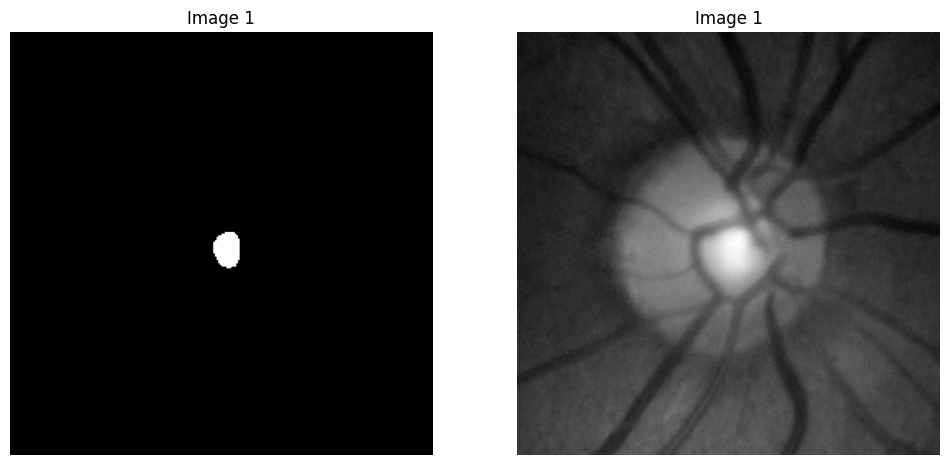

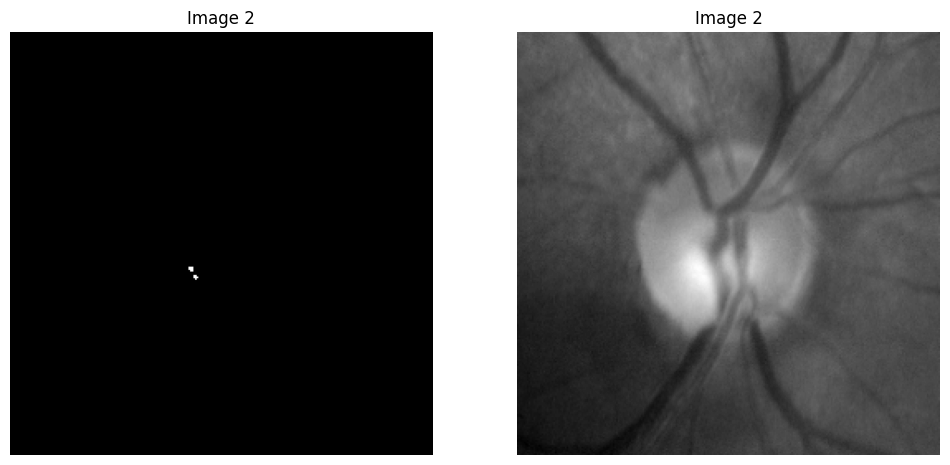

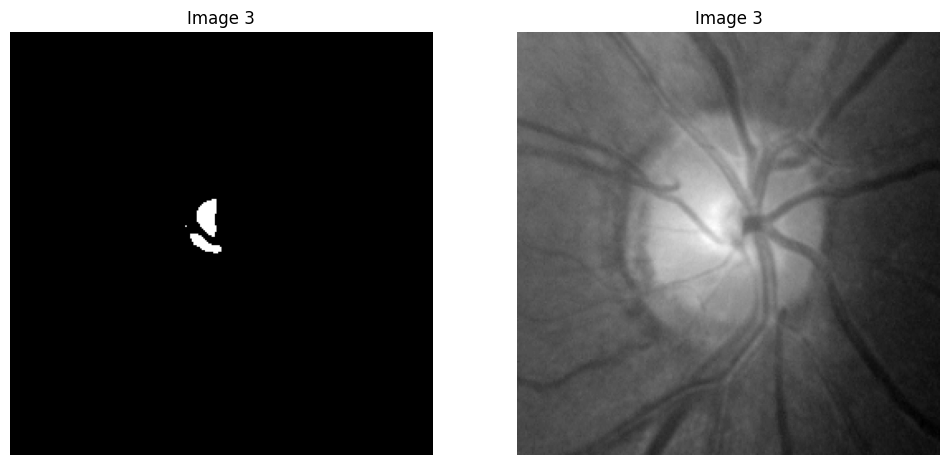

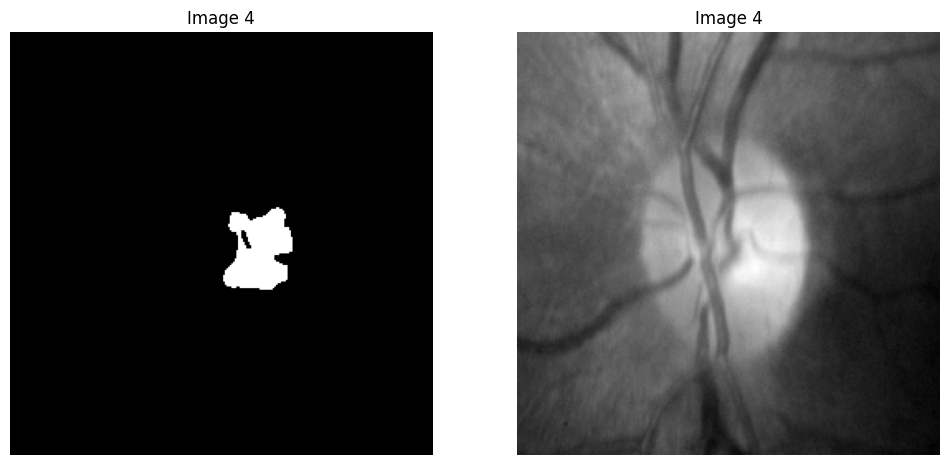

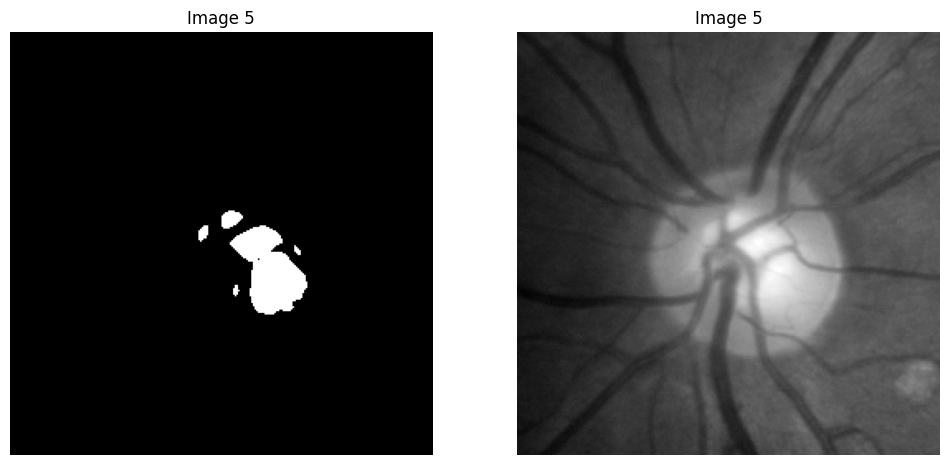

In [ ]:
#Postprocessing for the healthy images by doing soothing and thresholding

for i, filename in enumerate(os.listdir(directory_healthy_test)):
   if filename.endswith(".png"):
    file_path = os.path.join(directory_healthy_test, filename)
    img = cv2.imread(file_path)

    # Convert the image to grayscale
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    smoothed_img = cv2.GaussianBlur(gray_img,(5,5),0)
    ret, thresh_img = cv2.threshold(smoothed_img, 135, 255, cv2.THRESH_BINARY)

    # Display the grayscale image
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(thresh_img, cmap='gray')
    plt.axis('off')
    plt.title(f'Image {i+1}')

    plt.subplot(1, 2, 2)
    plt.imshow(gray_img, cmap='gray')
    plt.axis('off')
    plt.title(f'Image {i+1}')

    plt.show()


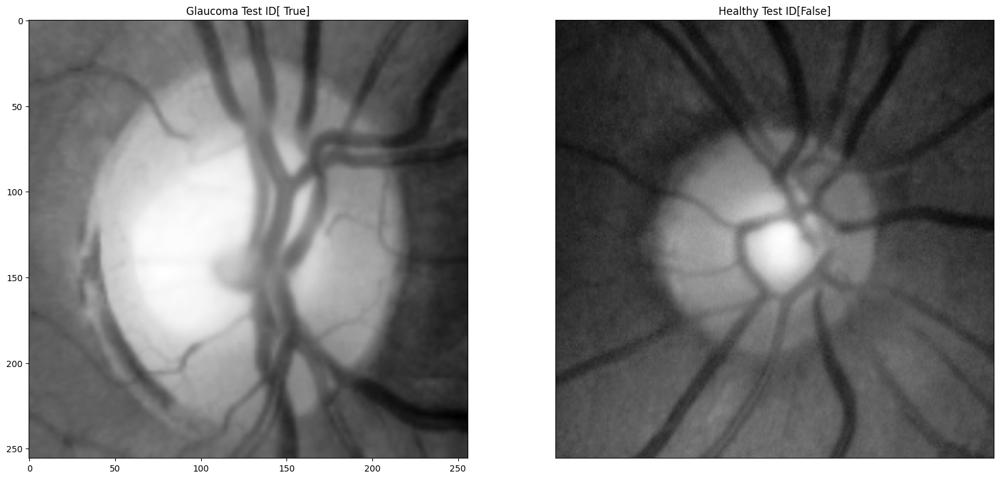

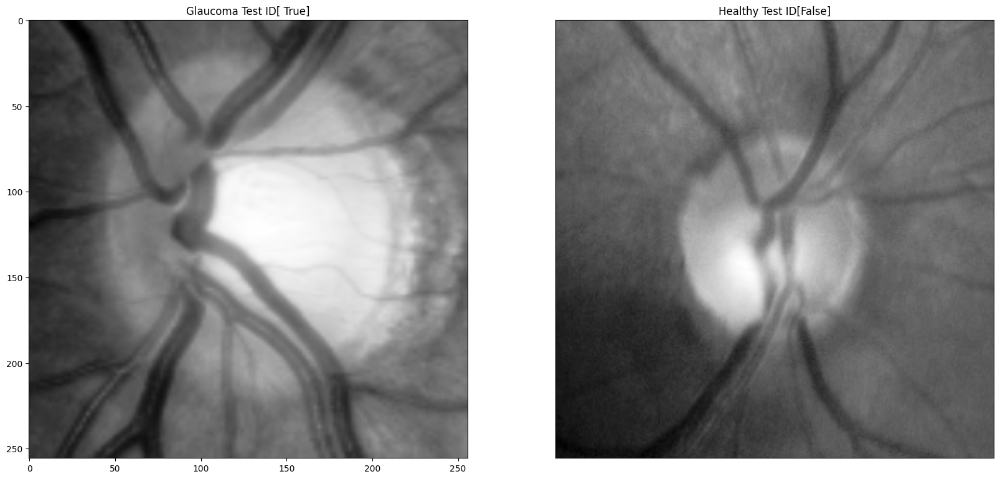

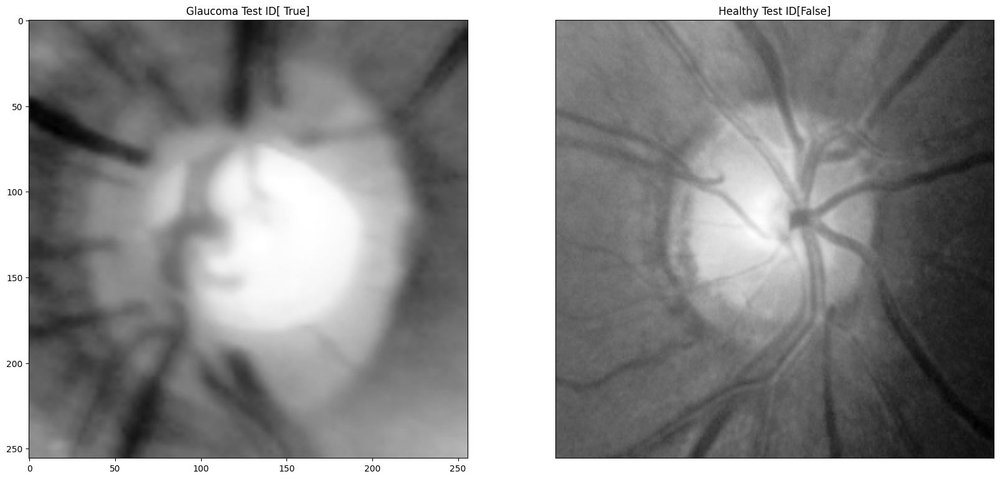

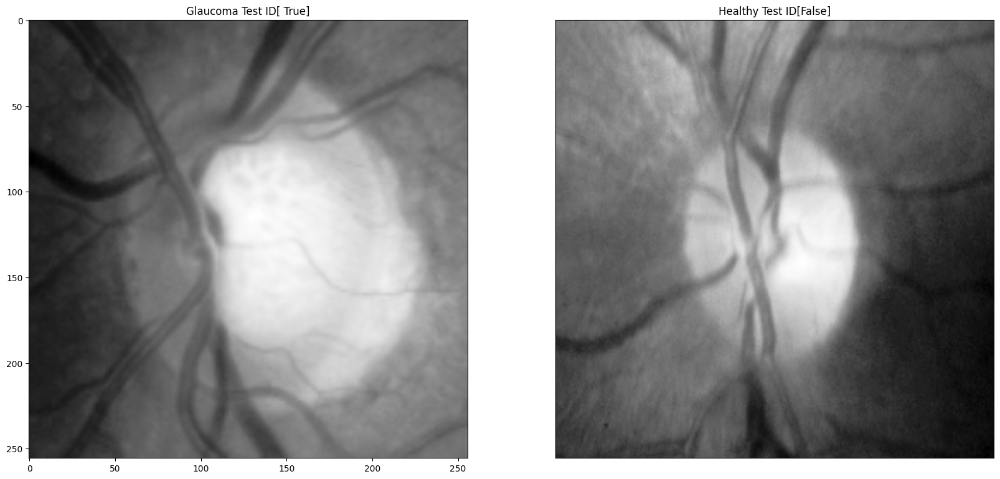

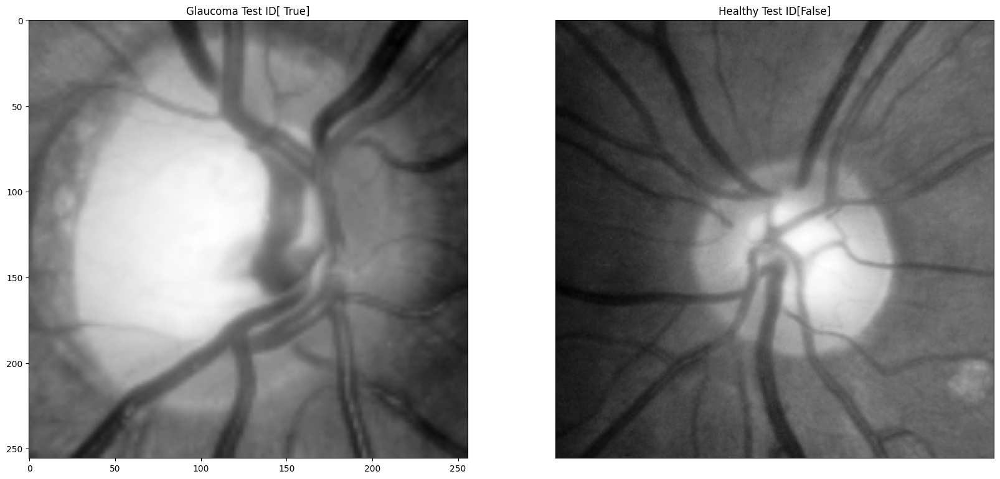

In [ ]:
#Printing the test images glocauma detected if out[i]>0.5 else not detected

for iPic in range(5):
    f,axarr=plt.subplots(1,2)

    axarr[0].imshow(originalGlaucomaTest[iPic],cmap='Greys_r')
    axarr[0].set_title('Glaucoma Test ID'+str(out[iPic]>.5))

    axarr[0].get_xaxis().set_visible(True)
    axarr[0].get_yaxis().set_visible(True)
    axarr[1].imshow(originalHealthyTest[iPic],cmap='Greys_r')
    axarr[1].set_title('Healthy Test ID'+str(out[iPic+5]>.5))

    axarr[1].get_xaxis().set_visible(False)
    axarr[1].get_yaxis().set_visible(False)



In [ ]:
#Tabulate the results
print("img id" , f"\t \tPrediction %", f"\t \tGlaucoma detected")
print("----------------------------------------------------------")
for i in range (len(out)):
  if out[i] > 0.5:
    print(i ,"\t \t", (out[i]/1.0) * 100,"\t \t", True)
  elif out[i]<0.5:
    print(i ,"\t \t", (out[i]/1.0) * 100,"\t \t", False)


img id 	 	Prediction % 	 	Glaucoma detected
----------------------------------------------------------
0 	 	 [51.506527] 	 	 True
1 	 	 [51.492332] 	 	 True
2 	 	 [54.047943] 	 	 True
3 	 	 [50.757362] 	 	 True
4 	 	 [52.721493] 	 	 True
5 	 	 [46.578194] 	 	 False
6 	 	 [45.95538] 	 	 False
7 	 	 [46.97919] 	 	 False
8 	 	 [47.25526] 	 	 False
9 	 	 [47.002865] 	 	 False
